# Grad Cam for Kaggle's Brain Comp
This notebook displays Grad Cam for the EfficientNetB0 model trained in version 5 of my EfficientNet starter notebook [here][1]. Grad Cam allows us to see where the model is giving its attention to when it makes a prediction. This helps us understand what is important in the spectrogram images. This knowledge helps us improve preprocessing, or improve model architecture, or engineer better features for our ML models like GBT CatBoost. There is a dicussion about this notebook [here][2]

[1]: https://www.kaggle.com/code/cdeotte/efficientnetb0-starter-lb-0-43
[2]: https://www.kaggle.com/competitions/hms-harmful-brain-activity-classification/discussion/472976

# Initialize 2xT4 GPU

In [1]:
import os, gc
os.environ["CUDA_VISIBLE_DEVICES"]="0,1"
import tensorflow as tf
import pandas as pd, numpy as np
import matplotlib.pyplot as plt
print('TensorFlow version =',tf.__version__)

# USE MULTIPLE GPUS
gpus = tf.config.list_physical_devices('GPU')
if len(gpus)<=1: 
    strategy = tf.distribute.OneDeviceStrategy(device="/gpu:0")
    print(f'Using {len(gpus)} GPU')
else: 
    strategy = tf.distribute.MirroredStrategy()
    print(f'Using {len(gpus)} GPUs')
    
# USE MIXED PRECISION
MIX = True
if MIX:
    tf.config.optimizer.set_experimental_options({"auto_mixed_precision": True})
    print('Mixed precision enabled')
else:
    print('Using full precision')

###############
    
VER = 5

# IF THIS EQUALS NONE, THEN WE TRAIN NEW MODELS
# IF THIS EQUALS DISK PATH, THEN WE LOAD PREVIOUSLY TRAINED MODELS
LOAD_MODELS_FROM = '../data/Brain-EfficientNet-Models-v3-v4-v5/'

USE_KAGGLE_SPECTROGRAMS = True
USE_EEG_SPECTROGRAMS = True

TensorFlow version = 2.18.0
Using 0 GPU
Mixed precision enabled


# Load Train Data and Create Non-Overlapping Eeg Ids

In [2]:
df = pd.read_csv('../data/hms-harmful-brain-activity-classification/train.csv')
TARGETS = df.columns[-6:]
print('Train shape:', df.shape )
print('Targets', list(TARGETS))

###########

train = df.groupby('eeg_id')[['spectrogram_id','spectrogram_label_offset_seconds']].agg(
    {'spectrogram_id':'first','spectrogram_label_offset_seconds':'min'})
train.columns = ['spec_id','min']

tmp = df.groupby('eeg_id')[['spectrogram_id','spectrogram_label_offset_seconds']].agg(
    {'spectrogram_label_offset_seconds':'max'})
train['max'] = tmp

tmp = df.groupby('eeg_id')[['patient_id']].agg('first')
train['patient_id'] = tmp

tmp = df.groupby('eeg_id')[TARGETS].agg('sum')
for t in TARGETS:
    train[t] = tmp[t].values
    
y_data = train[TARGETS].values
y_data = y_data / y_data.sum(axis=1,keepdims=True)
train[TARGETS] = y_data

tmp = df.groupby('eeg_id')[['expert_consensus']].agg('first')
train['target'] = tmp

train = train.reset_index()
print('Train non-overlapp eeg_id shape:', train.shape )
train.head()

Train shape: (106800, 15)
Targets ['seizure_vote', 'lpd_vote', 'gpd_vote', 'lrda_vote', 'grda_vote', 'other_vote']
Train non-overlapp eeg_id shape: (17089, 12)


,eeg_id,spec_id,min,max,patient_id,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote,target
0,568657,789577333,0.0,16.0,20654,0.0,0.000000,0.25,0.000000,0.166667,0.583333,Other
1,582999,1552638400,0.0,38.0,20230,0.0,0.857143,0.00,0.071429,0.000000,0.071429,LPD
2,642382,14960202,1008.0,1032.0,5955,0.0,0.000000,0.00,0.000000,0.000000,1.000000,Other
3,751790,618728447,908.0,908.0,38549,0.0,0.000000,1.00,0.000000,0.000000,0.000000,GPD
4,778705,52296320,0.0,0.0,40955,0.0,0.000000,0.00,0.000000,0.000000,1.000000,Other


# Read Train Spectrograms and EEG Spectrograms

In [3]:
READ_SPEC_FILES = False

# READ ALL SPECTROGRAMS
PATH = '../data/hms-harmful-brain-activity-classification/train_spectrograms/'
files = os.listdir(PATH)
print(f'There are {len(files)} spectrogram parquets')

if READ_SPEC_FILES:    
    spectrograms = {}
    for i,f in enumerate(files):
        if i%100==0: print(i,', ',end='')
        tmp = pd.read_parquet(f'{PATH}{f}')
        name = int(f.split('.')[0])
        spectrograms[name] = tmp.iloc[:,1:].values
else:
    spectrograms = np.load('../data/Brain-Spectrograms/specs.npy',allow_pickle=True).item()
    
###########

READ_EEG_SPEC_FILES = False

if READ_EEG_SPEC_FILES:
    all_eegs = {}
    for i,e in enumerate(train.eeg_id.values):
        if i%100==0: print(i,', ',end='')
        x = np.load(f'../data/Brain-EEG-Spectrograms/EEG_Spectrograms/{e}.npy')
        all_eegs[e] = x
else:
    all_eegs = np.load('../data/Brain-EEG-Spectrograms/eeg_specs.npy',allow_pickle=True).item()
    
print(f'There are {len(all_eegs)} eeg parquets')

There are 11138 spectrogram parquets
There are 17089 eeg parquets


# DataLoader

In [4]:
import albumentations as albu
TARS = {'Seizure':0, 'LPD':1, 'GPD':2, 'LRDA':3, 'GRDA':4, 'Other':5}
TARS2 = {x:y for y,x in TARS.items()}

class DataGenerator(tf.keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, data, batch_size=32, shuffle=False, augment=False, mode='train',
                 specs = spectrograms, eeg_specs = all_eegs): 

        self.data = data
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.augment = augment
        self.mode = mode
        self.specs = specs
        self.eeg_specs = eeg_specs
        self.on_epoch_end()
        
    def __len__(self):
        'Denotes the number of batches per epoch'
        ct = int( np.ceil( len(self.data) / self.batch_size ) )
        return ct

    def __getitem__(self, index):
        'Generate one batch of data'
        indexes = self.indexes[index*self.batch_size:(index+1)*self.batch_size]
        X, y = self.__data_generation(indexes)
        if self.augment: X = self.__augment_batch(X) 
        return X, y

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        self.indexes = np.arange( len(self.data) )
        if self.shuffle: np.random.shuffle(self.indexes)
                        
    def __data_generation(self, indexes):
        'Generates data containing batch_size samples' 
        
        X = np.zeros((len(indexes),128,256,8),dtype='float32')
        y = np.zeros((len(indexes),6),dtype='float32')
        img = np.ones((128,256),dtype='float32')
        
        for j,i in enumerate(indexes):
            row = self.data.iloc[i]
            if self.mode=='test': 
                r = 0
            else: 
                r = int( (row['min'] + row['max'])//4 )

            for k in range(4):
                # EXTRACT 300 ROWS OF SPECTROGRAM
                img = self.specs[row.spec_id][r:r+300,k*100:(k+1)*100].T
                
                # LOG TRANSFORM SPECTROGRAM
                img = np.clip(img,np.exp(-4),np.exp(8))
                img = np.log(img)
                
                # STANDARDIZE PER IMAGE
                ep = 1e-6
                m = np.nanmean(img.flatten())
                s = np.nanstd(img.flatten())
                img = (img-m)/(s+ep)
                img = np.nan_to_num(img, nan=0.0)
                
                # CROP TO 256 TIME STEPS
                X[j,14:-14,:,k] = img[:,22:-22] / 2.0
        
            # EEG SPECTROGRAMS
            img = self.eeg_specs[row.eeg_id]
            X[j,:,:,4:] = img
                
            if self.mode!='test':
                y[j,] = row[TARGETS]
            
        return X,y
    
    def __random_transform(self, img):
        composition = albu.Compose([
            albu.HorizontalFlip(p=0.5),
            #albu.CoarseDropout(max_holes=8,max_height=32,max_width=32,fill_value=0,p=0.5),
        ])
        return composition(image=img)['image']
            
    def __augment_batch(self, img_batch):
        for i in range(img_batch.shape[0]):
            img_batch[i, ] = self.__random_transform(img_batch[i, ])
        return img_batch

# Build Grad Cam Model

In [5]:
!pip install --no-index --find-links=../data/TF-EfficientNet-WHL-Files ../data/TF-EfficientNet-WHL-Files/efficientnet-1.1.1-py3-none-any.whl

Looking in links: ../data/TF-EfficientNet-WHL-Files
Processing /Users/csxiao/proj/Transformer-CRF_EEG/data/TF-EfficientNet-WHL-Files/efficientnet-1.1.1-py3-none-any.whl
efficientnet is already installed with the same version as the provided wheel. Use --force-reinstall to force an installation of the wheel.


In [6]:
import efficientnet.tfkeras as efn

def build_cam_model(pretrain=None):
    
    inp = tf.keras.Input(shape=(128,256,8))
    base_model = efn.EfficientNetB0(include_top=False, weights=None, input_shape=None)
    if pretrain:
        base_model.load_weights('../dataTF-EfficientNet-ImageNet-Weights/efficientnet-b0_weights_tf_dim_ordering_tf_kernels_autoaugment_notop.h5')
    
    # RESHAPE INPUT 128x256x8 => 512x512x3 MONOTONE IMAGE
    # KAGGLE SPECTROGRAMS
    x1 = [inp[:,:,:,i:i+1] for i in range(4)]
    x1 = tf.keras.layers.Concatenate(axis=1)(x1)
    # EEG SPECTROGRAMS
    x2 = [inp[:,:,:,i+4:i+5] for i in range(4)]
    x2 = tf.keras.layers.Concatenate(axis=1)(x2)
    # MAKE 512X512X3
    if USE_KAGGLE_SPECTROGRAMS & USE_EEG_SPECTROGRAMS:
        x = tf.keras.layers.Concatenate(axis=2)([x1,x2])
    elif USE_EEG_SPECTROGRAMS: x = x2
    else: x = x1
    x = tf.keras.layers.Concatenate(axis=3)([x,x,x])
    
    # OUTPUT
    x0 = base_model(x)
    x = tf.keras.layers.GlobalAveragePooling2D()(x0)
    x = tf.keras.layers.Dense(6,activation='softmax', dtype='float32')(x)
        
    # COMPILE MODEL
    model = tf.keras.Model(inputs=inp, outputs=[x,x0])
    opt = tf.keras.optimizers.Adam(learning_rate = 1e-3)
    loss = tf.keras.losses.KLDivergence()

    model.compile(loss=loss, optimizer = opt) 
        
    return model

In [7]:
from sklearn.model_selection import KFold, GroupKFold

gkf = GroupKFold(n_splits=5)
for fold, (train_index, valid_index) in enumerate(gkf.split(train, train.target, train.patient_id)): 
    # LOAD WEIGHTS INTO GRAD CAM MODEL
    with strategy.scope():
        model = build_cam_model()    
    model.load_weights(f'{LOAD_MODELS_FROM}EffNet_v{VER}_f{fold}.h5')
    layer_weights = model.layers[-1].get_weights()[0][:,0]
    break
    
print('Using fold 0 model and inferring fold 0 OOF (out of fold) samples...')

Using fold 0 model and inferring fold 0 OOF (out of fold) samples...


# Display Grad Cam
With grad cam, given a specific OOF (out of fold) train sample, we can view both a model's prediction and where it looked to make this prediction. In the plots below we display the image that was fed into our image model, in my popular starter notebook, there are 8 spectrograms that have been tiled into one 1 input image. 

On the left we have the 4 Kaggle spectrograms where each is 10 minutes long. Each represents one of the 4 montages LL, RL, LP, RP. (Montages explained [here][1]) On the right, we have the 4 EEG spectrograms where each is 50 seconds long. The EEG spectrograms are made from the Magic Formula [here][2]. The spectrograms are each `128x256x1`, so the final concatenation is `512x512x1`.

![](https://raw.githubusercontent.com/cdeotte/Kaggle_Images/main/Feb-2024/key2.png)

Each plot below has 3 subplots. The middle and right subplot use the KEY above. The left subplot is just the Grad Cam image where larger values (more yellow) indicates more attention. The middle subplot is the contours of the Grad Cam's 10% largest values superimposed over the image that we fed into our model. The right subplot is also Grad Cam contour superimposed over image but we add an emboss filter to the image to make the details more visible to humans. For explanations about specific grad cam examples, see discussion [here][3]

[1]: https://www.kaggle.com/competitions/hms-harmful-brain-activity-classification/discussion/467877
[2]: https://www.kaggle.com/competitions/hms-harmful-brain-activity-classification/discussion/469760
[3]: https://www.kaggle.com/competitions/hms-harmful-brain-activity-classification/discussion/472976

In [8]:
import cv2

# HELPER FUNCTION
def mask2contour(mask, width=5):
    w = mask.shape[1]
    h = mask.shape[0]
    mask2 = np.concatenate([mask[:,width:],np.zeros((h,width))],axis=1)
    mask2 = np.logical_xor(mask,mask2)
    mask3 = np.concatenate([mask[width:,:],np.zeros((width,w))],axis=0)
    mask3 = np.logical_xor(mask,mask3)
    return np.logical_or(mask2,mask3) 

clahe = cv2.createCLAHE(clipLimit=16.0, tileGridSize=(8,8))


#########################
### SEIZURE_VOTE
#########################
Found 526 samples in fold zero OOF for seizure_vote with true>0.5


/opt/homebrew/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
2024-11-07 08:22:27.280417: W tensorflow/core/framework/dataset.cc:993] Input of GeneratorDatasetOp::Dataset will not be optimized because the dataset does not implement the AsGraphDefInternal() method needed to apply optimizations.
2024-11-07 08:22:27.558928: I tensorflow/core/framework/local_rendezvous.cc:405] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node MultiDeviceIteratorGetNextFromShard}}]]



==> TRUE:  seizure=1.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.704 lpd=0.004 gpd=0.004 lrda=0.101 grda=0.031 other=0.155


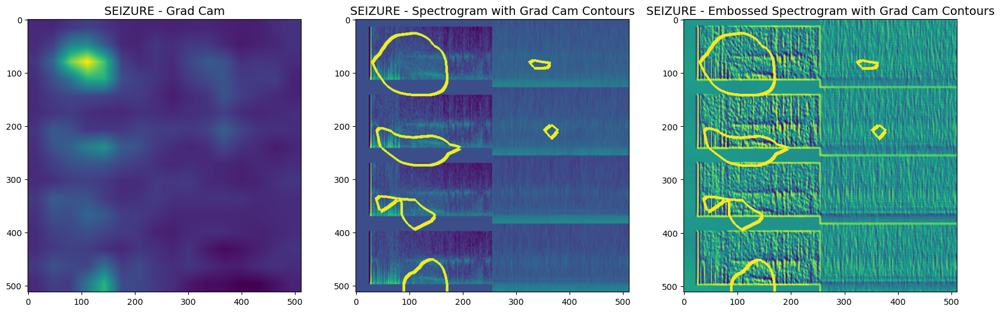


==> TRUE:  seizure=0.533 lpd=0.000 gpd=0.400 lrda=0.000 grda=0.000 other=0.067
==> PRED:  seizure=0.557 lpd=0.011 gpd=0.365 lrda=0.003 grda=0.013 other=0.051


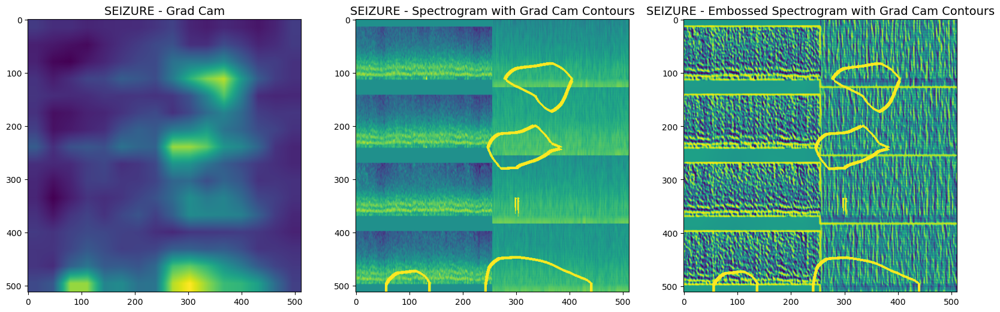


==> TRUE:  seizure=1.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.806 lpd=0.116 gpd=0.004 lrda=0.058 grda=0.001 other=0.015


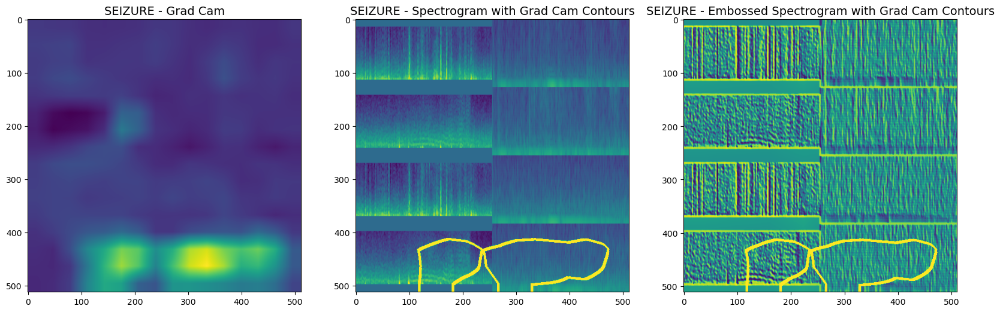


==> TRUE:  seizure=0.941 lpd=0.029 gpd=0.000 lrda=0.000 grda=0.000 other=0.029
==> PRED:  seizure=0.884 lpd=0.016 gpd=0.008 lrda=0.013 grda=0.003 other=0.076


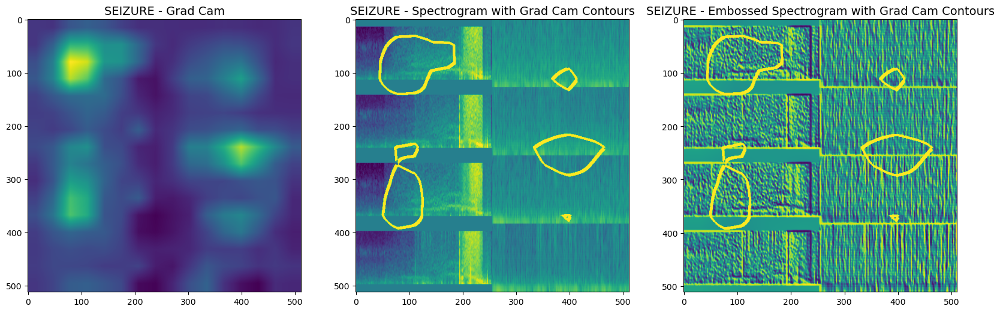


==> TRUE:  seizure=1.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.704 lpd=0.002 gpd=0.001 lrda=0.017 grda=0.002 other=0.273


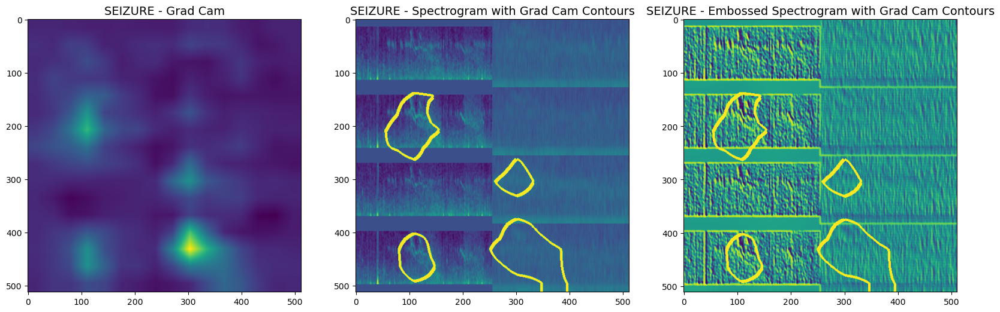


==> TRUE:  seizure=1.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.960 lpd=0.001 gpd=0.001 lrda=0.013 grda=0.004 other=0.021


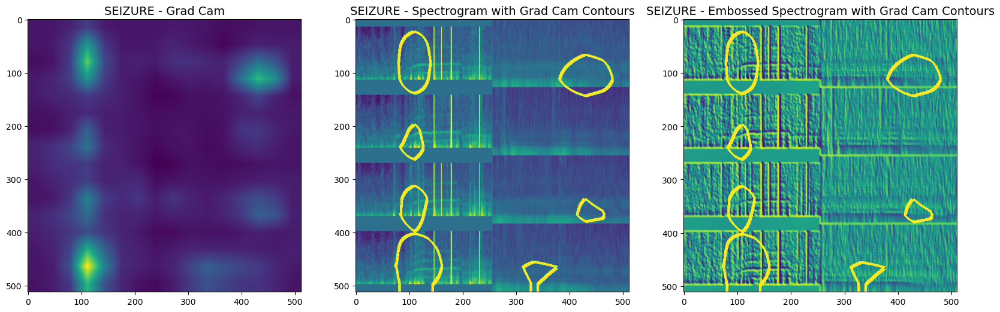


==> TRUE:  seizure=1.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.965 lpd=0.007 gpd=0.003 lrda=0.006 grda=0.010 other=0.009


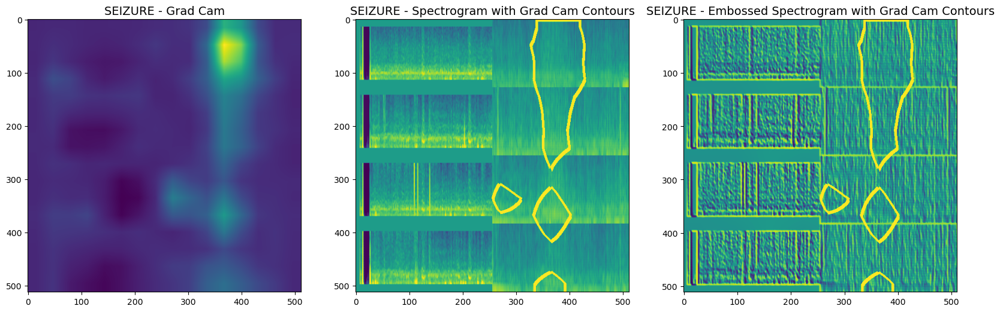


==> TRUE:  seizure=1.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.751 lpd=0.027 gpd=0.126 lrda=0.018 grda=0.060 other=0.019


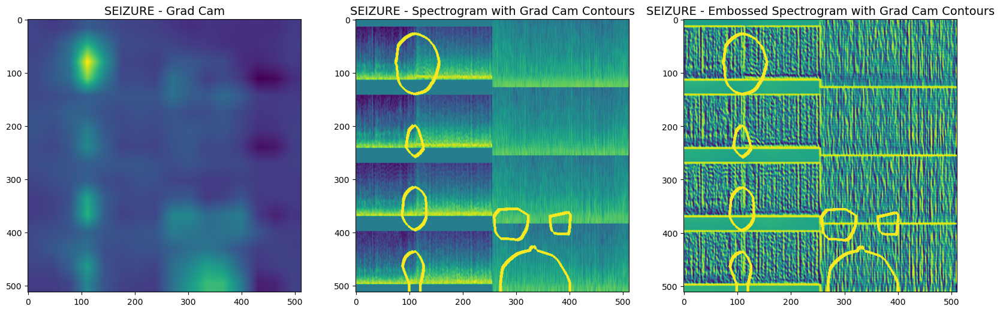


#########################
### LPD_VOTE
#########################
Found 305 samples in fold zero OOF for lpd_vote with true>0.5


/opt/homebrew/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
2024-11-07 08:23:00.943540: W tensorflow/core/framework/dataset.cc:993] Input of GeneratorDatasetOp::Dataset will not be optimized because the dataset does not implement the AsGraphDefInternal() method needed to apply optimizations.
2024-11-07 08:23:01.230867: I tensorflow/core/framework/local_rendezvous.cc:405] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node MultiDeviceIteratorGetNextFromShard}}]]



==> TRUE:  seizure=0.000 lpd=0.750 gpd=0.000 lrda=0.250 grda=0.000 other=0.000
==> PRED:  seizure=0.005 lpd=0.905 gpd=0.001 lrda=0.020 grda=0.001 other=0.067


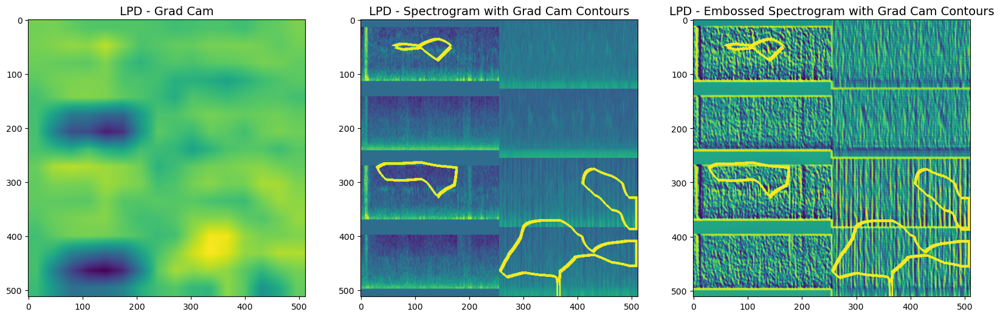


==> TRUE:  seizure=0.000 lpd=1.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.014 lpd=0.599 gpd=0.025 lrda=0.003 grda=0.001 other=0.357


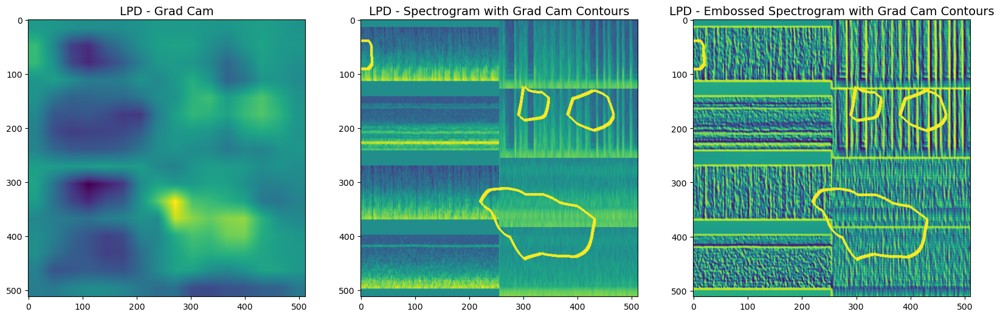


==> TRUE:  seizure=0.000 lpd=1.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.020 lpd=0.601 gpd=0.007 lrda=0.177 grda=0.008 other=0.187


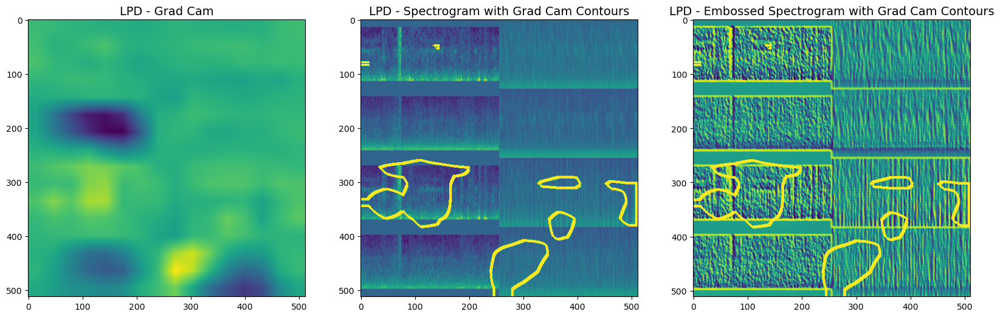


==> TRUE:  seizure=0.000 lpd=1.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.017 lpd=0.932 gpd=0.002 lrda=0.001 grda=0.000 other=0.047


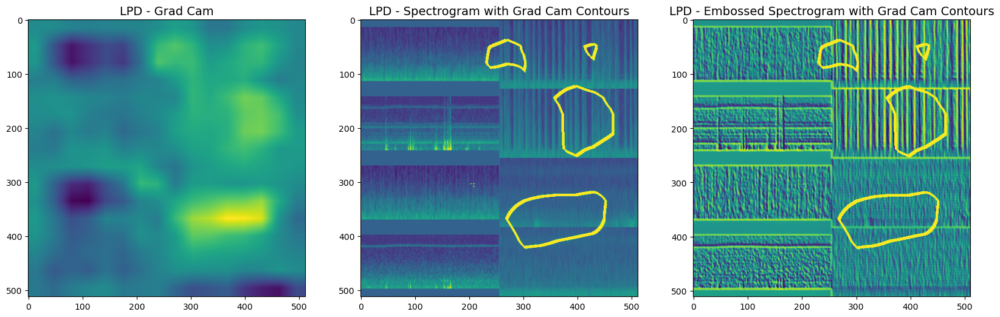


==> TRUE:  seizure=0.000 lpd=1.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.004 lpd=0.888 gpd=0.001 lrda=0.030 grda=0.001 other=0.075


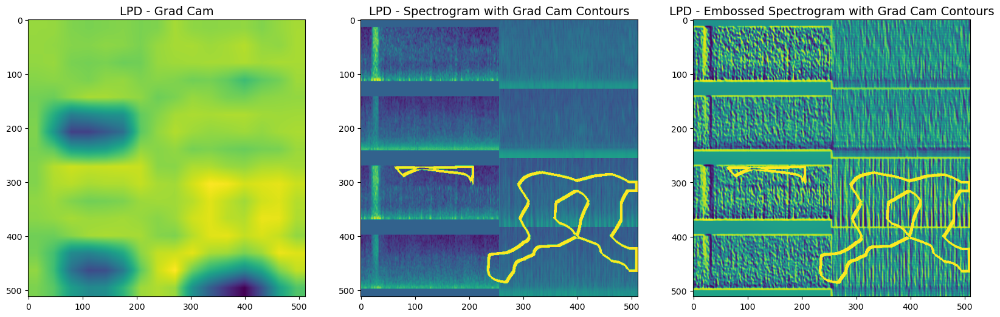


==> TRUE:  seizure=0.000 lpd=1.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.016 lpd=0.922 gpd=0.004 lrda=0.001 grda=0.000 other=0.056


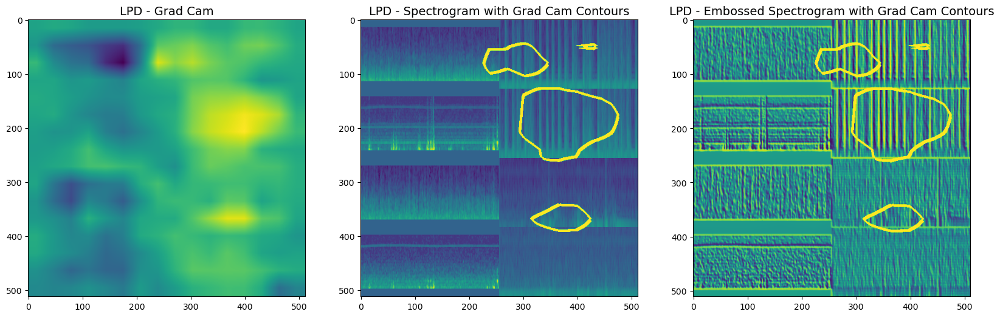


==> TRUE:  seizure=0.000 lpd=1.000 gpd=0.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.052 lpd=0.748 gpd=0.001 lrda=0.002 grda=0.000 other=0.197


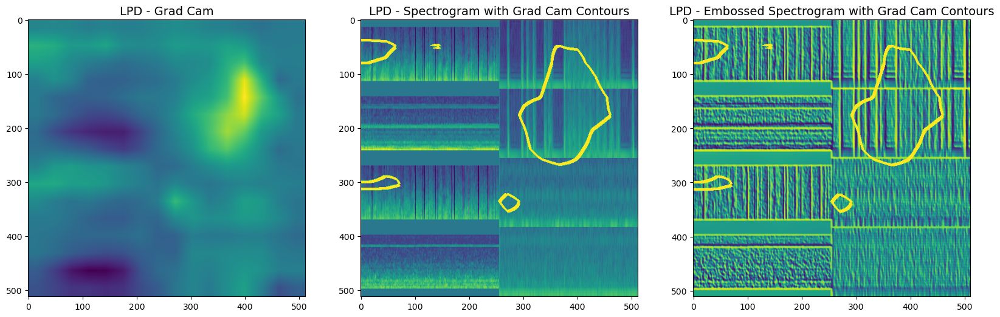


==> TRUE:  seizure=0.000 lpd=0.529 gpd=0.000 lrda=0.294 grda=0.000 other=0.176
==> PRED:  seizure=0.011 lpd=0.507 gpd=0.191 lrda=0.025 grda=0.029 other=0.237


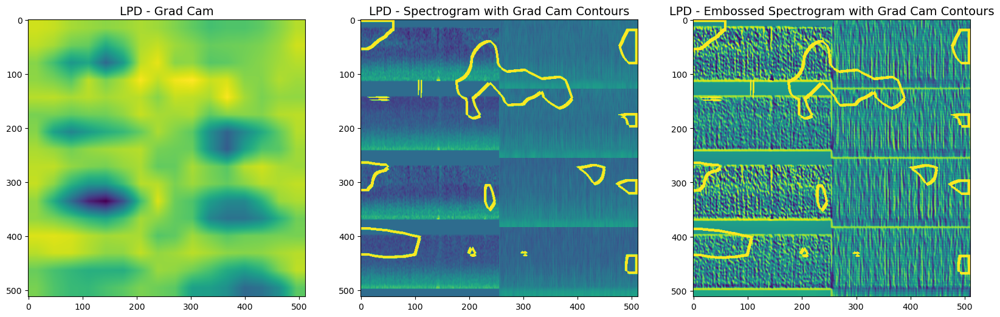


#########################
### GPD_VOTE
#########################
Found 414 samples in fold zero OOF for gpd_vote with true>0.5


/opt/homebrew/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
2024-11-07 08:23:38.530865: W tensorflow/core/framework/dataset.cc:993] Input of GeneratorDatasetOp::Dataset will not be optimized because the dataset does not implement the AsGraphDefInternal() method needed to apply optimizations.



==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.688 lrda=0.000 grda=0.062 other=0.250
==> PRED:  seizure=0.005 lpd=0.074 gpd=0.788 lrda=0.004 grda=0.030 other=0.099


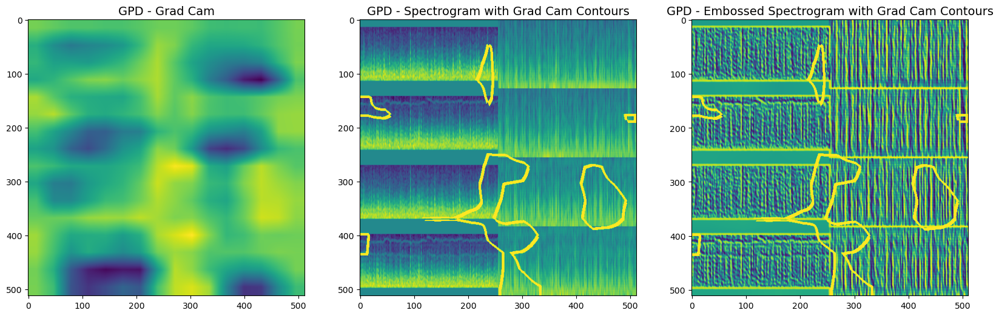


==> TRUE:  seizure=0.000 lpd=0.000 gpd=1.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.032 lpd=0.090 gpd=0.813 lrda=0.003 grda=0.019 other=0.042


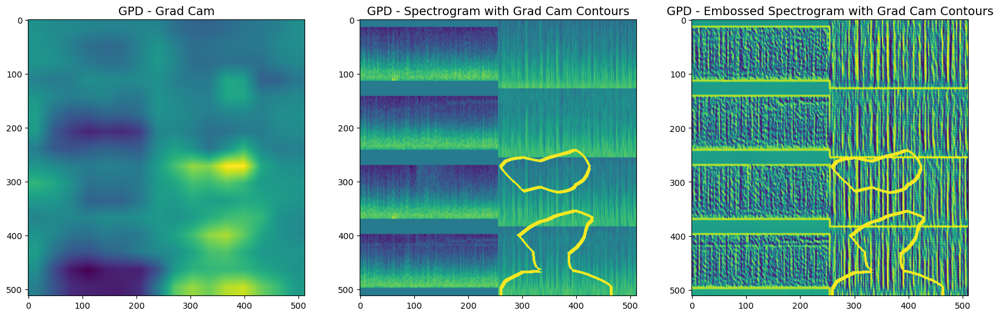


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.933 lrda=0.000 grda=0.000 other=0.067
==> PRED:  seizure=0.004 lpd=0.014 gpd=0.924 lrda=0.000 grda=0.000 other=0.057


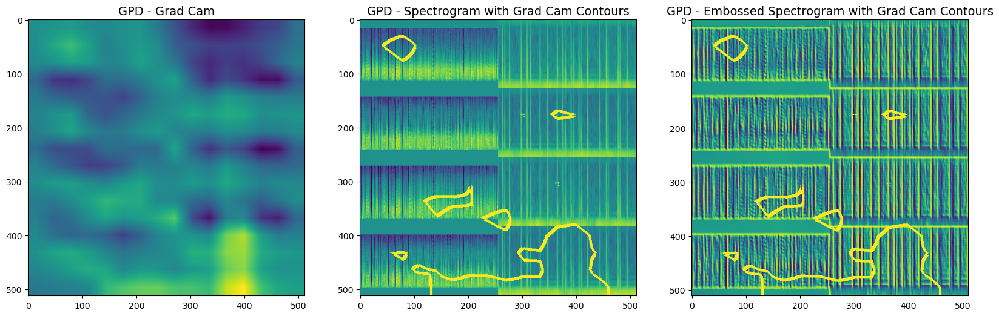


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.929 lrda=0.000 grda=0.000 other=0.071
==> PRED:  seizure=0.111 lpd=0.152 gpd=0.593 lrda=0.038 grda=0.046 other=0.060


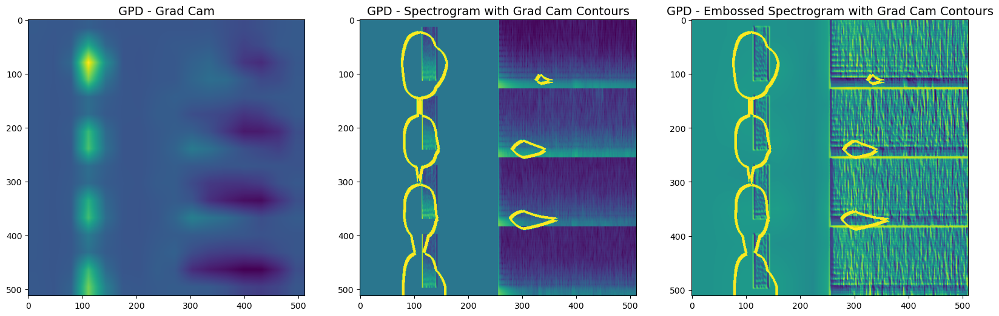


==> TRUE:  seizure=0.000 lpd=0.000 gpd=1.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.003 lpd=0.067 gpd=0.796 lrda=0.007 grda=0.064 other=0.062


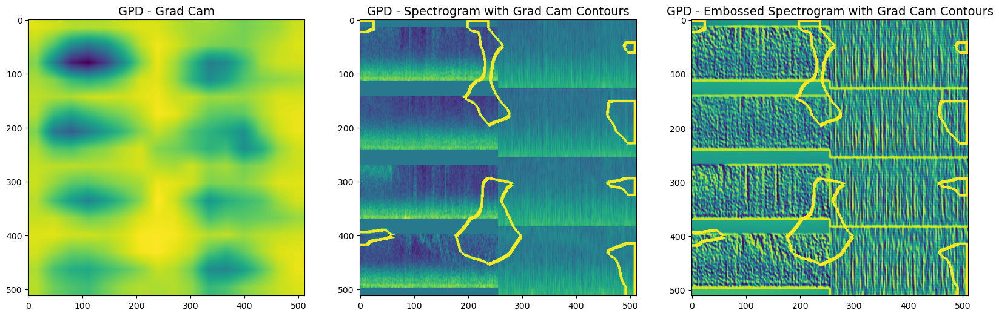


==> TRUE:  seizure=0.000 lpd=0.000 gpd=1.000 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.006 lpd=0.008 gpd=0.743 lrda=0.001 grda=0.006 other=0.236


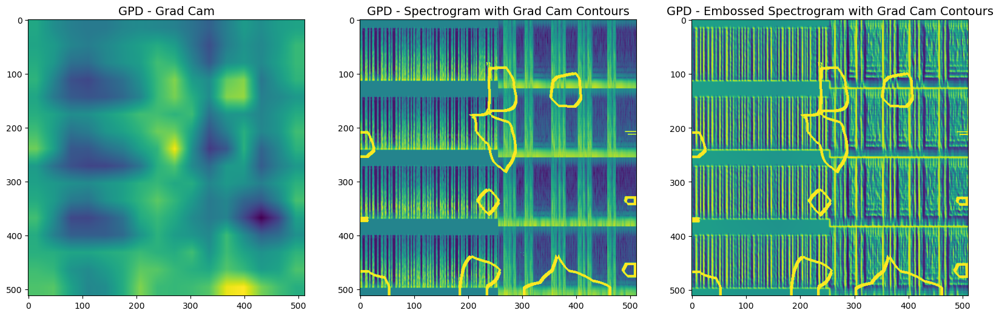


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.857 lrda=0.000 grda=0.000 other=0.143
==> PRED:  seizure=0.004 lpd=0.004 gpd=0.705 lrda=0.000 grda=0.001 other=0.286


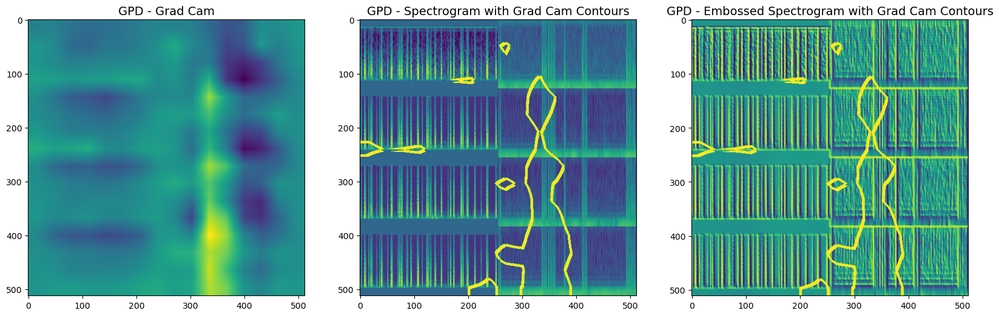


==> TRUE:  seizure=0.500 lpd=0.000 gpd=0.500 lrda=0.000 grda=0.000 other=0.000
==> PRED:  seizure=0.332 lpd=0.016 gpd=0.587 lrda=0.005 grda=0.021 other=0.039


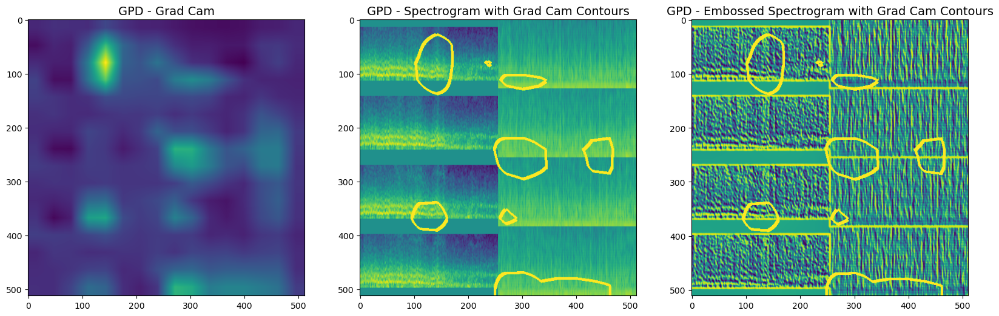


#########################
### LRDA_VOTE
#########################
Found 185 samples in fold zero OOF for lrda_vote with true>0.5


/opt/homebrew/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
2024-11-07 08:24:14.658403: W tensorflow/core/framework/dataset.cc:993] Input of GeneratorDatasetOp::Dataset will not be optimized because the dataset does not implement the AsGraphDefInternal() method needed to apply optimizations.
2024-11-07 08:24:14.928288: I tensorflow/core/framework/local_rendezvous.cc:405] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node MultiDeviceIteratorGetNextFromShard}}]]



==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.667 grda=0.333 other=0.000
==> PRED:  seizure=0.033 lpd=0.025 gpd=0.010 lrda=0.636 grda=0.174 other=0.123


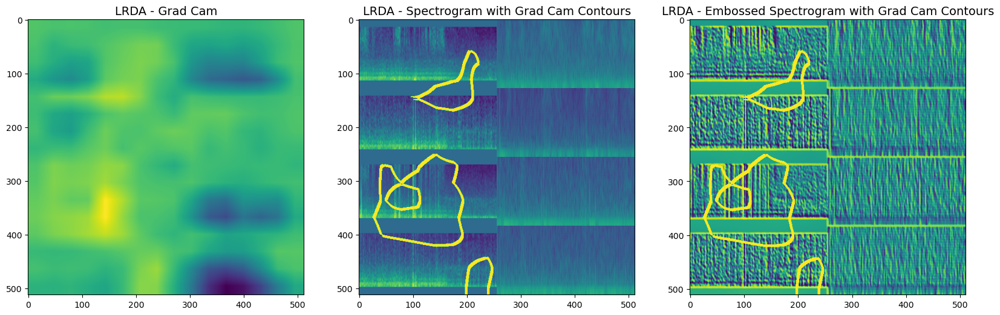


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.667 grda=0.000 other=0.333
==> PRED:  seizure=0.008 lpd=0.031 gpd=0.013 lrda=0.523 grda=0.325 other=0.101


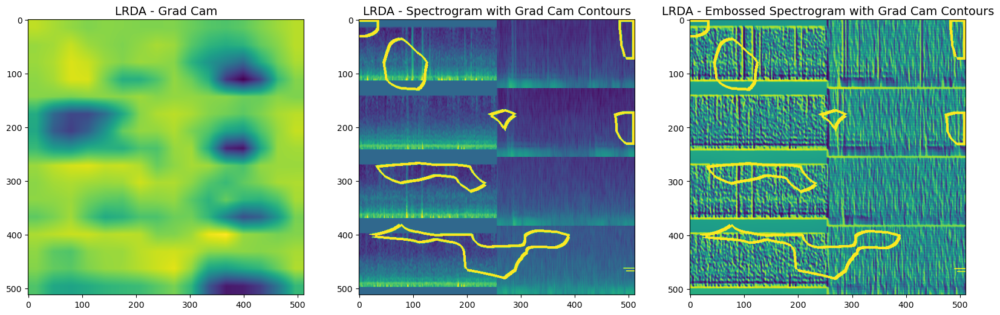


==> TRUE:  seizure=0.000 lpd=0.333 gpd=0.000 lrda=0.667 grda=0.000 other=0.000
==> PRED:  seizure=0.006 lpd=0.017 gpd=0.000 lrda=0.700 grda=0.058 other=0.219


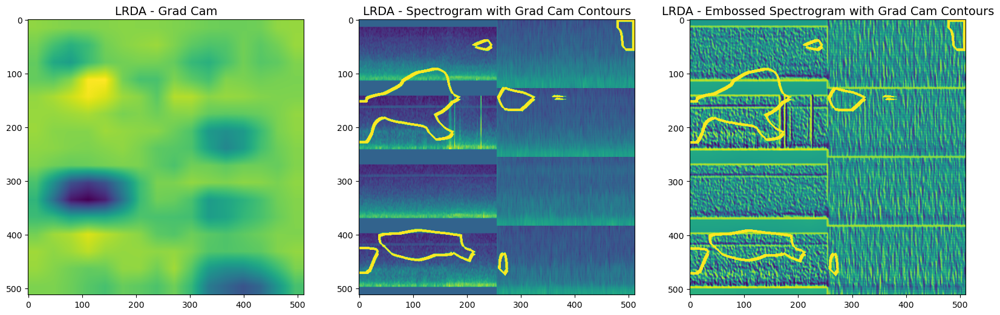


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.500 grda=0.000 other=0.500
==> PRED:  seizure=0.005 lpd=0.018 gpd=0.000 lrda=0.809 grda=0.041 other=0.125


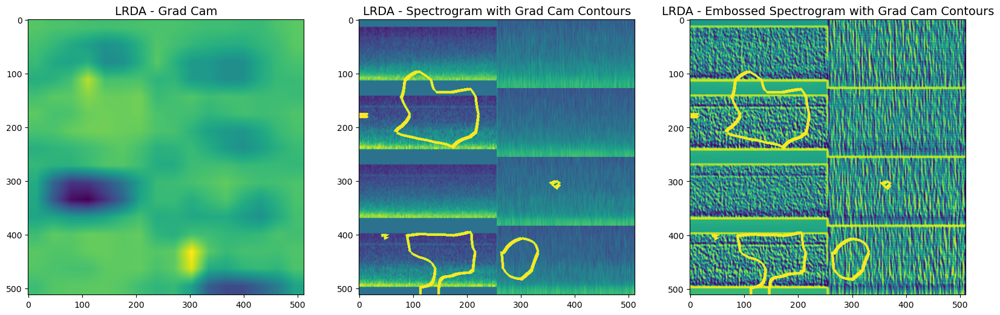


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=1.000 grda=0.000 other=0.000
==> PRED:  seizure=0.010 lpd=0.069 gpd=0.004 lrda=0.816 grda=0.038 other=0.064


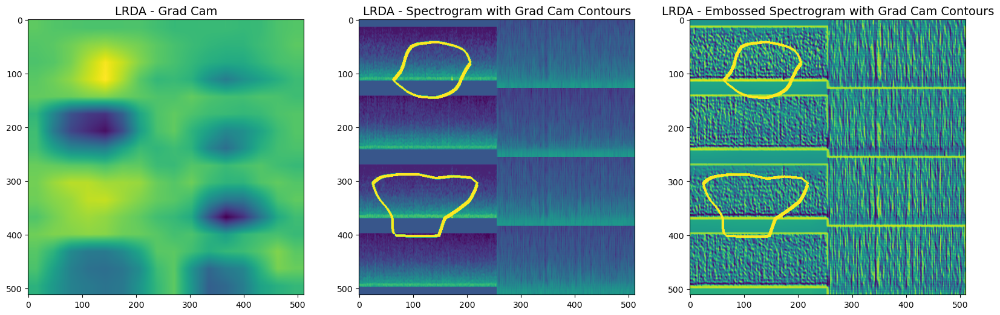


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.667 grda=0.000 other=0.333
==> PRED:  seizure=0.008 lpd=0.019 gpd=0.001 lrda=0.546 grda=0.238 other=0.189


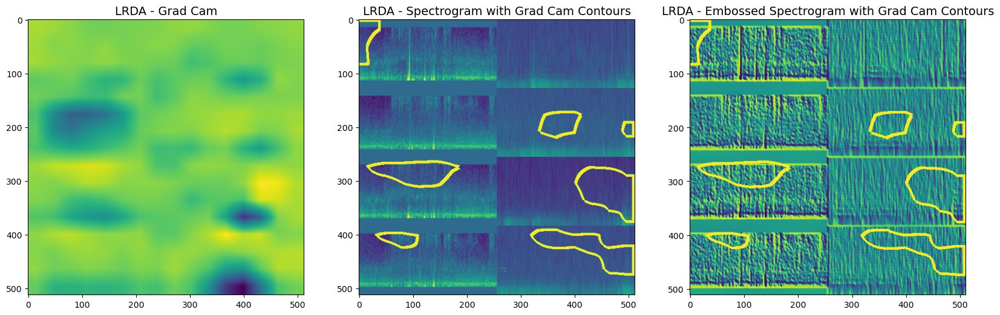


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.667 grda=0.000 other=0.333
==> PRED:  seizure=0.049 lpd=0.065 gpd=0.008 lrda=0.525 grda=0.266 other=0.088


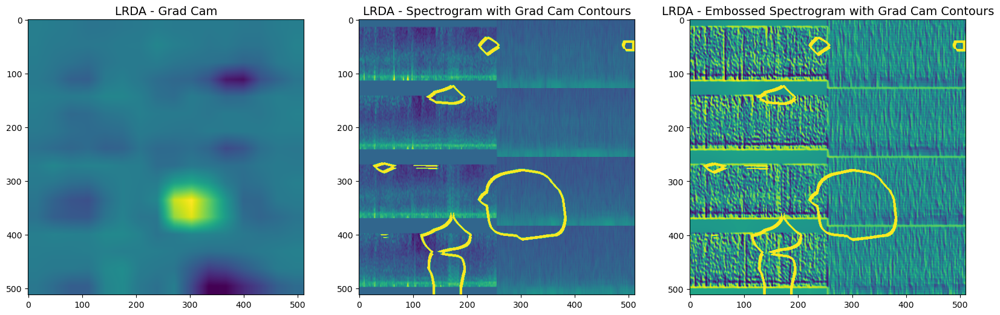


#########################
### GRDA_VOTE
#########################
Found 412 samples in fold zero OOF for grda_vote with true>0.5


/opt/homebrew/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()



==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=1.000 other=0.000
==> PRED:  seizure=0.001 lpd=0.002 gpd=0.005 lrda=0.058 grda=0.843 other=0.091


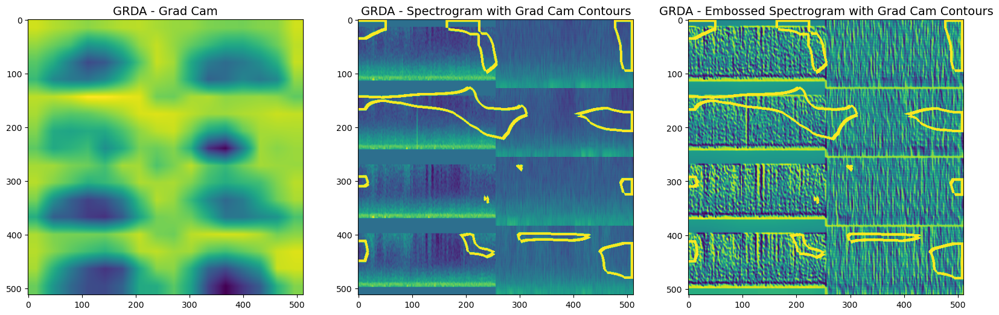


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=1.000 other=0.000
==> PRED:  seizure=0.010 lpd=0.022 gpd=0.036 lrda=0.073 grda=0.562 other=0.297


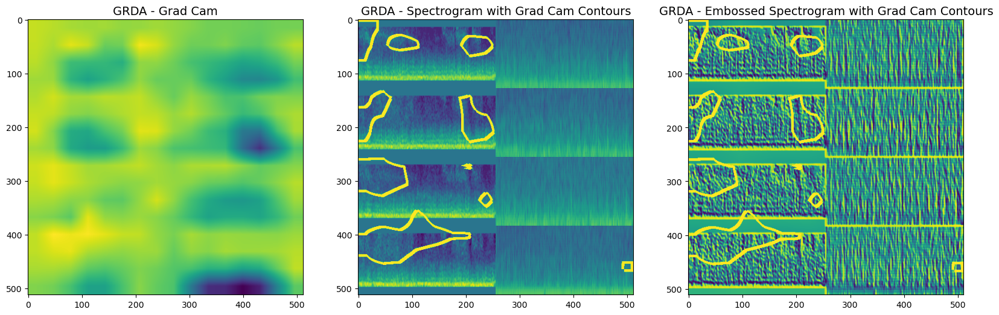


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.067 lrda=0.000 grda=0.600 other=0.333
==> PRED:  seizure=0.003 lpd=0.003 gpd=0.023 lrda=0.020 grda=0.825 other=0.125


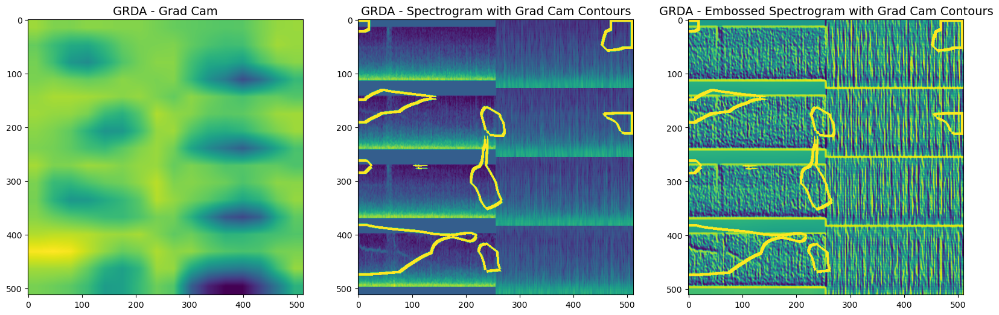


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=1.000 other=0.000
==> PRED:  seizure=0.001 lpd=0.001 gpd=0.001 lrda=0.024 grda=0.924 other=0.049


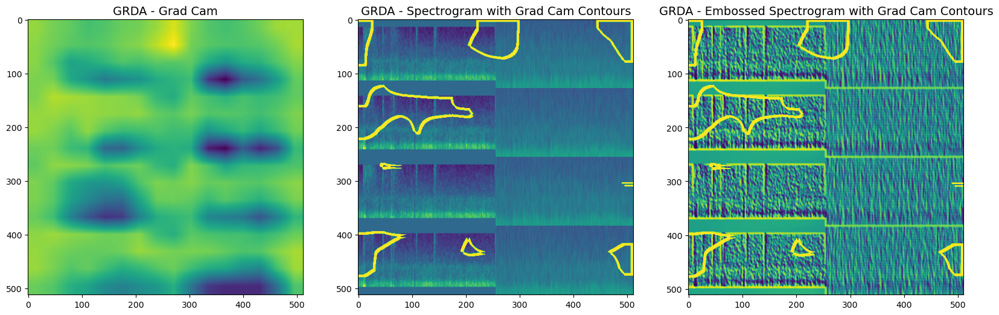


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=1.000 other=0.000
==> PRED:  seizure=0.011 lpd=0.001 gpd=0.001 lrda=0.087 grda=0.867 other=0.033


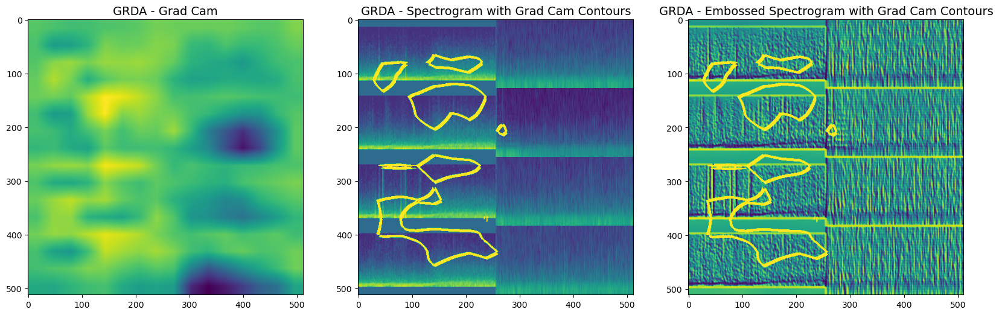


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=1.000 other=0.000
==> PRED:  seizure=0.004 lpd=0.016 gpd=0.021 lrda=0.044 grda=0.785 other=0.130


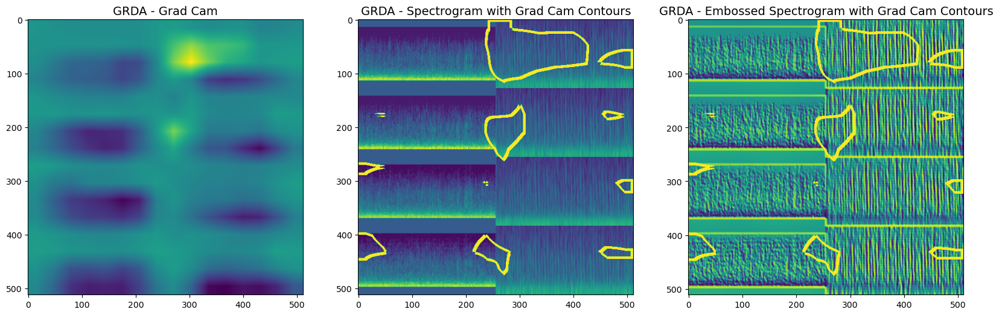


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=1.000 other=0.000
==> PRED:  seizure=0.005 lpd=0.005 gpd=0.004 lrda=0.215 grda=0.720 other=0.050


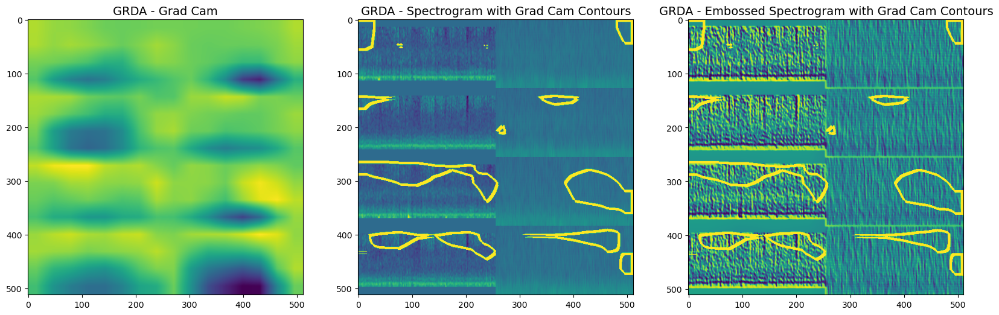


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=1.000 other=0.000
==> PRED:  seizure=0.180 lpd=0.022 gpd=0.009 lrda=0.095 grda=0.653 other=0.040


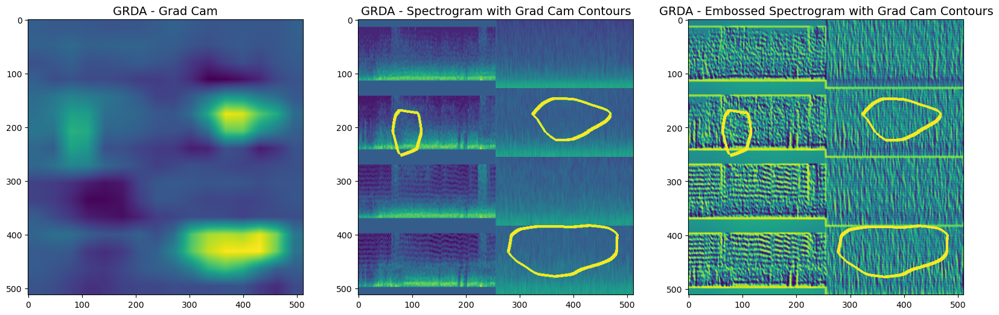


#########################
### OTHER_VOTE
#########################
Found 1386 samples in fold zero OOF for other_vote with true>0.5


/opt/homebrew/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
2024-11-07 08:25:13.407969: W tensorflow/core/framework/dataset.cc:993] Input of GeneratorDatasetOp::Dataset will not be optimized because the dataset does not implement the AsGraphDefInternal() method needed to apply optimizations.



==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=0.000 other=1.000
==> PRED:  seizure=0.001 lpd=0.001 gpd=0.000 lrda=0.023 grda=0.037 other=0.937


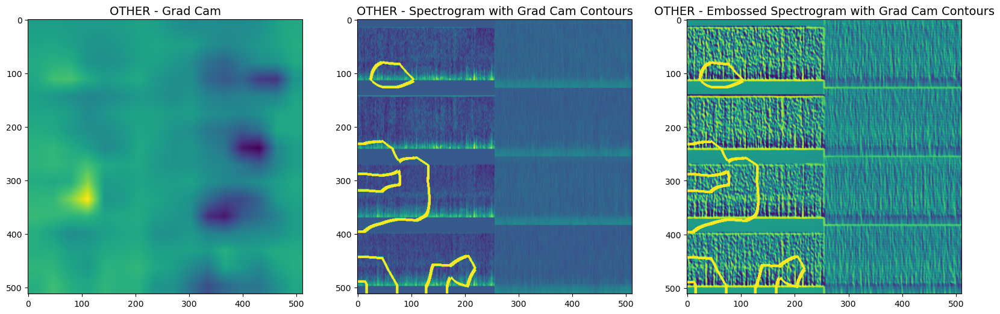


==> TRUE:  seizure=0.000 lpd=0.333 gpd=0.000 lrda=0.000 grda=0.000 other=0.667
==> PRED:  seizure=0.010 lpd=0.051 gpd=0.073 lrda=0.025 grda=0.078 other=0.763


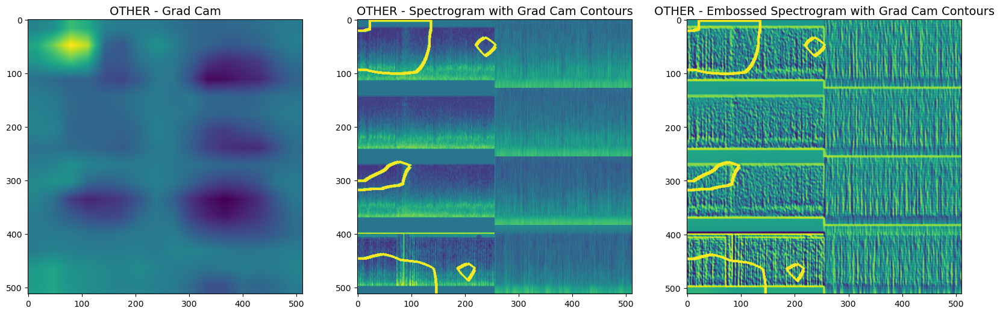


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=0.417 other=0.583
==> PRED:  seizure=0.007 lpd=0.010 gpd=0.004 lrda=0.053 grda=0.180 other=0.746


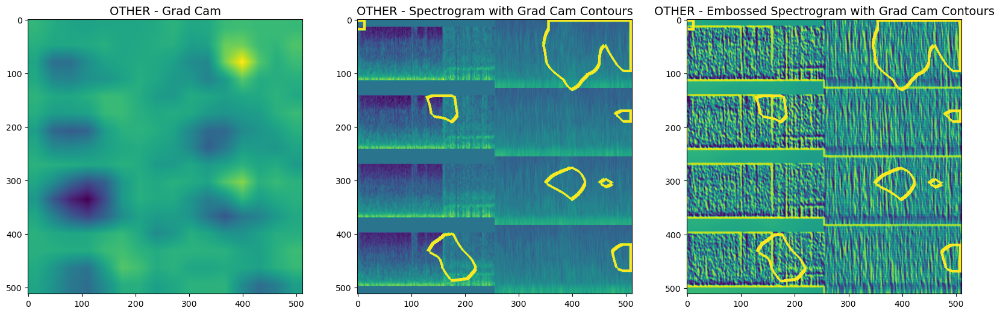


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.059 lrda=0.000 grda=0.059 other=0.882
==> PRED:  seizure=0.168 lpd=0.002 gpd=0.008 lrda=0.036 grda=0.026 other=0.762


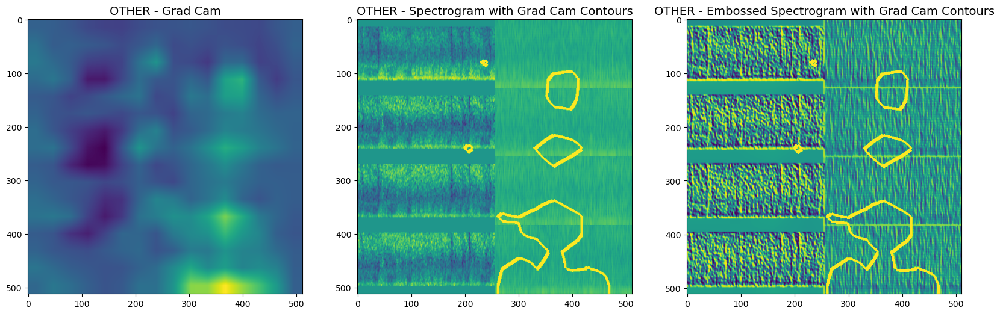


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=0.154 other=0.846
==> PRED:  seizure=0.101 lpd=0.043 gpd=0.045 lrda=0.034 grda=0.254 other=0.523


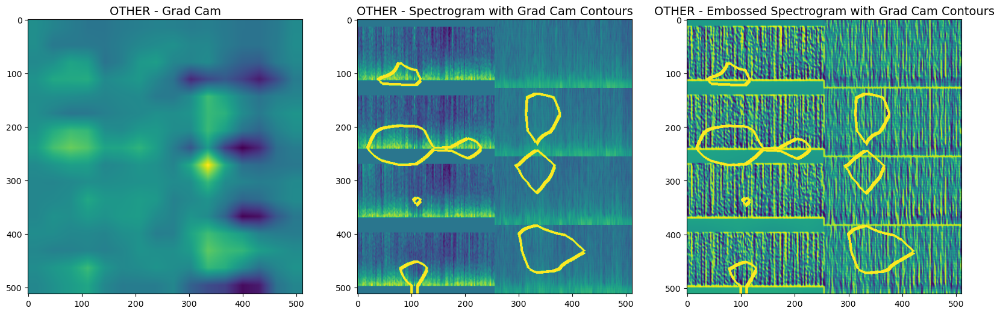


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=0.000 other=1.000
==> PRED:  seizure=0.009 lpd=0.000 gpd=0.001 lrda=0.007 grda=0.007 other=0.975


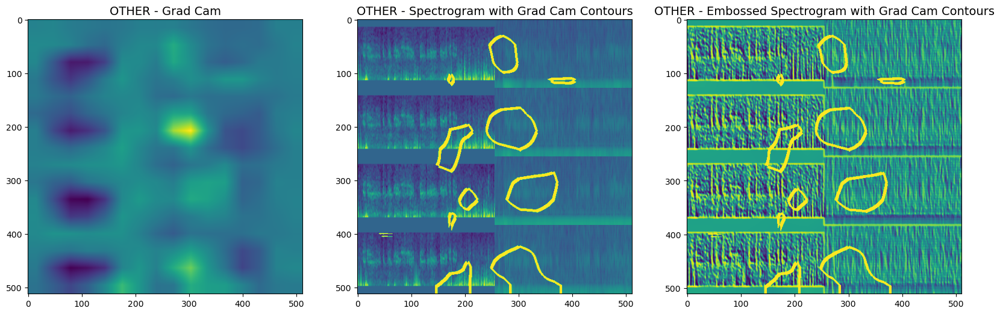


==> TRUE:  seizure=0.000 lpd=0.000 gpd=0.000 lrda=0.000 grda=0.000 other=1.000
==> PRED:  seizure=0.001 lpd=0.002 gpd=0.008 lrda=0.006 grda=0.094 other=0.888


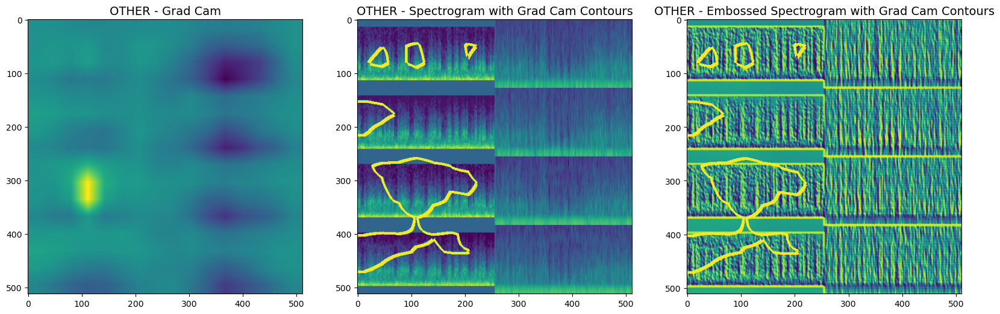


==> TRUE:  seizure=0.000 lpd=0.167 gpd=0.000 lrda=0.000 grda=0.083 other=0.750
==> PRED:  seizure=0.055 lpd=0.150 gpd=0.015 lrda=0.055 grda=0.009 other=0.716


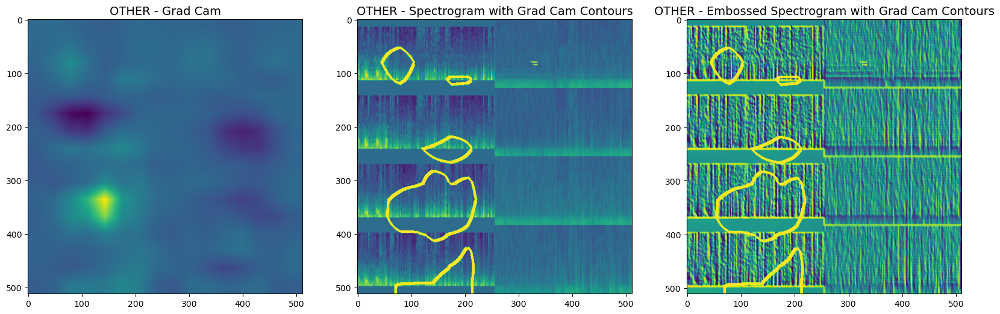

In [9]:
save_dir = "../image"
if not os.path.exists(save_dir):
    os.makedirs(save_dir)

BATCH = 128

for ii,tt in enumerate(TARGETS):
    ttt = tt.split('_')[0].upper()
    
    print()
    print('#'*25)
    print('###',tt.upper())
    print('#'*25)
    
    # FIND TRAIN SAMPLES IN OOF (OUT OF FOLD) WITH TARGET >= 0.5
    IDX = train.loc[train.index.isin(valid_index) & (train[tt]>=0.5),TARGETS].index.values
    print(f'Found {len(IDX)} samples in fold zero OOF for {tt} with true>0.5')
    
    # INFER TRAIN SAMPLES WITH MODEL (SAVE PREDS AND ACTIVATIONS)
    valid_gen = DataGenerator(train.iloc[IDX[:128]], shuffle=False, batch_size=BATCH, mode='valid')
    p,xx = model.predict(valid_gen,verbose=0)
    #print(xx.shape)
    
    # DISPLAY GRAD CAM
    for x,y in valid_gen:
        ct = 0
        for i in range(BATCH):
            
            # FIND SAMPLES WITH PRED >= 0.5 FOR TARGET
            if i>=len(p): continue
            pred = p[i]
            if pred[ii]<0.5: continue
                
            # FORMAT PREDICTIONS AS STRING
            pred2 = ''; true2 = ''
            true = train.loc[IDX[i]][TARGETS].values
            for j,t in enumerate(TARGETS):
                n = t.split('_')[0]
                pred2 += f' {n}={pred[j]:0.3f}'
                true2 += f' {n}={true[j]:0.3f}'
            print()
            print('==> TRUE:',true2)
            print('==> PRED:',pred2)

            # PLOT GRAD CAM RESULTS
            plt.figure(figsize=(20,8))

            # PLOT GRAD CAM IMAGE (PLOT 1 OF 3)
            plt.subplot(1,3,1)
            img = np.sum(xx[i,] * layer_weights,axis=-1)
            img = cv2.resize(img,(512,512))
            plt.imshow(img[::-1,])
            plt.title(f'{ttt} - Grad Cam',size=14)

            # FIND GRAD CAM CONTOURS FOR AREAS OF INTEREST
            cut = np.percentile(img.flatten(), [90])[0]
            cntr = img.copy()
            cntr[cntr>=cut] = 100
            cntr[cntr<cut] = 0
            cntr = mask2contour(cntr)

            # PLOT EMBOSSED SPECTROGRAMS WITH GRADCAM CONTOURS (PLOT 3 OF 3)
            plt.subplot(1,3,3)
            x1 = [x[i,:,:,k:k+1] for k in range(4)] #KAGGLE-SPECS: LL RL LP RP
            x1 = np.concatenate(x1,axis=0)  
            x2 = [x[i,:,:,k+4:k+5] for k in range(4)] #EEG-SPECS: LL LP RL RP
            x2 = np.concatenate(x2,axis=0)
            x3 = np.concatenate([x1,x2],axis=1)
            img = cv2.resize(x3,(512,512))
            img0 = img.copy()

            # EMBOSS IMAGE FOR IMAGE FEATURE VISIBILITY
            img = img[1:,1:] - img[:-1,:-1] #emboss
            img -= np.min(img)
            img /= np.max(img)
            img = (img*255).astype('uint8')
            img = cv2.GaussianBlur(img,(5,5),0)
            img = clahe.apply(img)
            mx = np.max(img)

            cntr2 = cntr[1:,1:]
            img[cntr2>0] = mx
            plt.imshow(img[::-1,])
            plt.title(f'{ttt} - Embossed Spectrogram with Grad Cam Contours',size=14)

            # PLOT SPECTROGRAMS WITH GRADCAM CONTOURS (PLOT 2 OF 3)
            plt.subplot(1,3,2)        
            mx = np.max(img0)
            img0[cntr>0] = mx
            plt.imshow(img0[::-1,])
            plt.title(f'{ttt} - Spectrogram with Grad Cam Contours',size=14)
            
            # Save each figure as a separate PDF file
            save_path = os.path.join(save_dir, f'grad_cam_{ttt}_{i}.pdf')
            plt.savefig(save_path, format='pdf', bbox_inches='tight', pad_inches=0.1)
            plt.show()
            ct += 1
            if ct==8: break

        break